In [1]:
import KMALL
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import math

In [2]:
#Loading the data
ping_data = KMALL.kmall('data/0038_20230414_174524.kmwcd')
ping_data.index_file()

# get a summary of the data
ping_data.report_packet_types()

# filter for MRZ packets
IWMC = ping_data.Index['MessageType'] == '#MWC'
MWCIndex = ping_data.Index[IWMC]
print(f'--First few data types of MWZ packets--\n{MWCIndex.head()}')

dg = lambda ping: ping_data.read_index_row(MWCIndex.iloc[ping-1])
ping=1
df=dg(ping)
print(df)

if df["header"]["dgmType"] == b"#MWC":
    beamdata = pd.DataFrame.from_dict(df["beamData"])
    print('RXInfo:',df['rxInfo'])
    print('Partition:',df['partition'])
    print('CmnPart:',df['cmnPart'])
    print('TXInfo:', df['txInfo'])
    print('Sectordata:', df['sectorData'])

             Count     Size:  Min Size  Max Size
MessageType                                     
#CHE           273     10920        40        40
#IIP             1      1106      1106      1106
#IOP             1      1248      1248      1248
#MWC           273  32013396    115900    125156
#SVP             1       112       112       112
--First few data types of MWZ packets--
              ByteOffset  MessageSize MessageType
Time                                             
1.681494e+09        2506       117100        #MWC
1.681494e+09      119646       117124        #MWC
1.681494e+09      236810       117092        #MWC
1.681494e+09      353942       117108        #MWC
1.681494e+09      471090       117124        #MWC
{'header': {'numBytesDgm': 117100, 'dgmType': b'#MWC', 'dgmVersion': 2, 'systemID': 40, 'echoSounderID': 2040, 'dgtime': 1681494324.729435, 'dgdatetime': datetime.datetime(2023, 4, 14, 17, 45, 24, 729435)}, 'partition': {'numOfDgms': 1, 'dgmNum': 1}, 'cmnPart': {'num

c:\Users\Chris Lam\Documents\GitHub\kmall\KMALL\kmall.py:3720: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  msg_type_group = self.Index.groupby("MessageType")


In [3]:
def pipeline(dg):
    beamAmp=pd.DataFrame.from_dict(dg['beamData']['sampleAmplitude05dB_p'])
    numsamp=dg['beamData']['numSampleData']
    SoundSp=dg["rxInfo"]["soundVelocity_mPerSec"]
    SampleFreq=dg["rxInfo"]["sampleFreq_Hz"]
    TVGFuncApplied=dg["rxInfo"]["TVGfunctionApplied"]
    TVGOffset=dg["rxInfo"]["TVGoffset_dB"]
    txBeamWidth=(dg['sectorData']['txBeamWidthAlong_deg'])
    beamAngle=np.array(beamdata["beamPointAngReVertical_deg"])
    RxBeamWidth=1
    length=np.arange(1,len(beamAmp.columns)).tolist()
    rang=[x*.5*SoundSp/SampleFreq for x in length]
    #length should be 594
    rang.insert(0,10e-9)
    #not sure if this is right, i am extending rng to be a matrix for element wise operations later, and making a transposed matrix to try to also make things work
    rng=np.tile(rang,((beamAmp).shape[0],1))
    rnge=pd.DataFrame(rng).T
    #z and y are both transposed here to allow for operations later
    za=-(np.cos(beamAngle*np.pi/180)*rnge)
    ya=(np.sin(beamAngle*np.pi/180)*rnge)
    z=pd.DataFrame(za).T
    y=pd.DataFrame(ya).T
    Awc=beamAmp/2
    X = TVGFuncApplied
    C = TVGOffset
    RTval=10*np.log10((np.pi/180)*(txBeamWidth[0]*np.pi/180))
    TS = (Awc + RTval * np.ones(Awc.shape)).T - (float(X) * np.log10(np.ones((len(rnge),1))*rnge))+(40*np.log10(np.ones((len(Awc.T),1))*rnge))-float(C)
    recieveAngle=1/np.cos(beamAngle*np.pi/180)
    RxRad=RxBeamWidth*np.pi/180
    langth=2*rnge*np.sin(RxRad/2)
    TxRad=txBeamWidth[0]*np.pi/180*recieveAngle
    width=((2*np.ones([rnge.shape[0],len(TxRad)])*rnge)*np.sin(TxRad/2)).T
    beamArea=langth*width.T
    Tau=3500/1e5 #ask about this part, what is tau in the metadata?
    Sv=np.zeros(TS.size)
    Vol_log=10*np.log(beamArea*Tau*SoundSp/2)
    Sv=TS-Vol_log
    return Sv,ya,za

C:\Users\Chris Lam\AppData\Local\Temp\ipykernel_35928\3036886.py:8: UserWarning: The input coordinates to pcolor are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolor.
  plt.pcolor(ya1, za1, Sv1, vmin=-120, vmax=-60, cmap='inferno', shading='auto')
C:\Users\Chris Lam\AppData\Local\Temp\ipykernel_35928\3036886.py:9: UserWarning: The input coordinates to pcolor are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolor.
  plt.pcolor(ya1.loc[:500],za1.loc[:500],Sv1.loc[:499,:],vmin=-120,vmax=-60,cmap='inferno') #change vmin and vmax to change␣colormap and bring out different features
C:\Users\Chris Lam\AppData\Local\Temp\ipykernel_35928\3036886.py:10: MatplotlibDeprecationWarning: Getting the array from a PolyQuadM

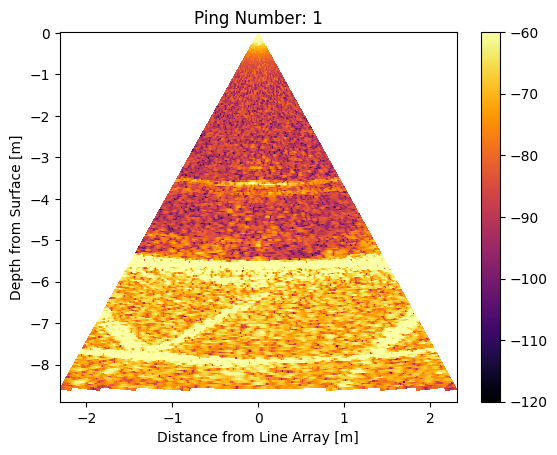

In [4]:
Sv1,ya1,za1=pipeline(df)

plt.figure()
plt.title('Ping Number: {}'.format(ping) )
plt.ylabel('Depth from Surface [m]')
plt.xlabel('Distance from Line Array [m]')
# plot the average Sv over the first 2 pings
plt.pcolor(ya1, za1, Sv1, vmin=-120, vmax=-60, cmap='inferno', shading='auto')
plt.pcolor(ya1.loc[:500],za1.loc[:500],Sv1.loc[:499,:],vmin=-120,vmax=-60,cmap='inferno') #change vmin and vmax to change␣colormap and bring out different features
plt.colorbar()
#plt.pcolor(ya,za[:200],Sv.loc[:199,:],norm='linear')
plt.show()

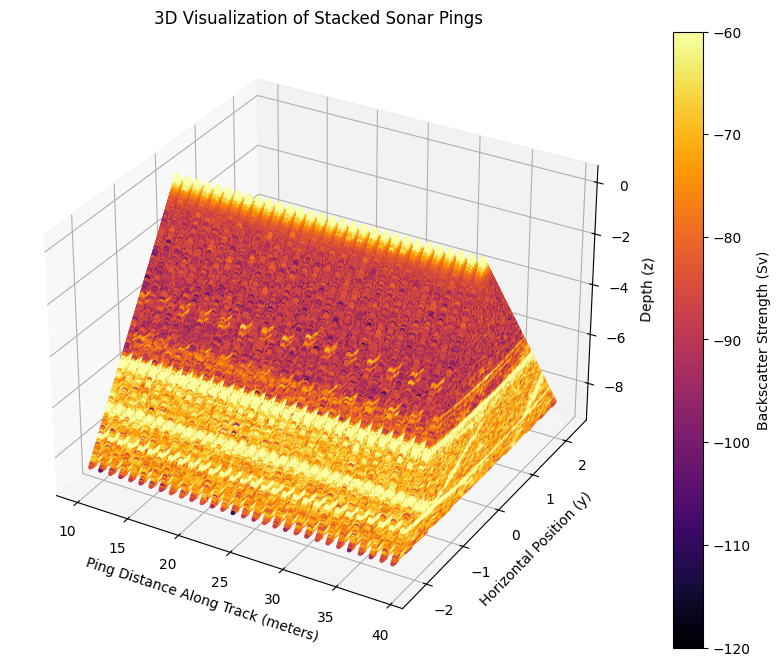

In [46]:
import numpy as np

import matplotlib.pyplot as plt

from mpl_toolkits.mplot3d import Axes3D


def plot_stacked_pings(pipeline, num_pings, distance_between_pings=10):

    fig = plt.figure(figsize=(12, 8))

    ax = fig.add_subplot(111, projection='3d')


    for i in range(10,num_pings+10):

        # Call the pipeline function to get Sv, ya, za for each ping

        ping_data = dg(i + 1)

        Sv, ya, za = pipeline(ping_data)  # assuming pings start from index 1

        

        # Add a constant offset to x for each ping

        x_coords = np.full_like(ya, i * distance_between_pings)


        # Plot the Sv data as a colored scatter plot

        sc = ax.scatter(x_coords, ya, za, c=Sv, cmap='inferno', vmin=-120, vmax=-60, s=5)

    

    # Adding color bar to represent Sv values

    cbar = fig.colorbar(sc, ax=ax, label="Backscatter Strength (Sv)")

    

    # Set labels

    ax.set_xlabel('Ping Distance Along Track (meters)')

    ax.set_ylabel('Horizontal Position (y)')

    ax.set_zlabel('Depth (z)')

    plt.title("3D Visualization of Stacked Sonar Pings")

    

    plt.show()


# Assuming `pipeline` is already defined and provides Sv, ya, za

plot_stacked_pings(pipeline, num_pings=30, distance_between_pings=1)

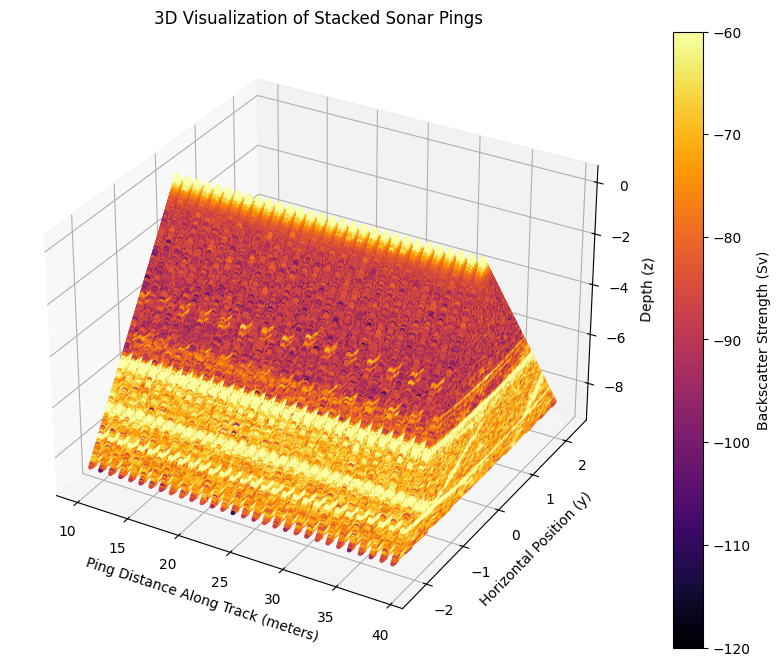

In [47]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation

def plot_stacked_pings(pipeline, num_pings, distance_between_pings=10):
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Store scatter plots for each ping
    scatters = []

    for i in range(10, num_pings + 10):
        # Call the pipeline function to get Sv, ya, za for each ping
        ping_data = dg(i + 1)
        Sv, ya, za = pipeline(ping_data)  # assuming pings start from index 1
        
        # Add a constant offset to x for each ping
        x_coords = np.full_like(ya, i * distance_between_pings)

        # Create a scatter plot for each ping and store it
        sc = ax.scatter(x_coords, ya, za, c=Sv, cmap='inferno', vmin=-120, vmax=-60, s=5)
        scatters.append(sc)

    # Adding color bar to represent Sv values
    cbar = fig.colorbar(scatters[0], ax=ax, label="Backscatter Strength (Sv)")

    # Set labels
    ax.set_xlabel('Ping Distance Along Track (meters)')
    ax.set_ylabel('Horizontal Position (y)')
    ax.set_zlabel('Depth (z)')
    plt.title("3D Visualization of Stacked Sonar Pings")

    # Function to update the view angle for rotation
    def update(frame):
        ax.view_init(elev=20, azim=frame)  # Adjust the elevation and azimuth angles
        return scatters

    # Create animation
    ani = FuncAnimation(fig, update, frames=np.arange(0, 360, 2), blit=False)

    plt.show()

# Assuming `pipeline` is already defined and provides Sv, ya, za
plot_stacked_pings(pipeline, num_pings=30, distance_between_pings=1)


In [51]:
import numpy as np
import plotly.graph_objects as go

def plot_stacked_pings(pipeline, num_pings, distance_between_pings=10):
    # Create lists to hold the data for all pings
    x_data = []
    y_data = []
    z_data = []
    Sv_data = []

    for i in range(10, num_pings + 10):
        # Call the pipeline function to get Sv, ya, za for each ping
        ping_data = dg(i + 1)
        Sv, ya, za = pipeline(ping_data)  # assuming pings start from index 1
        
        # Add a constant offset to x for each ping
        x_coords = np.full_like(ya, i * distance_between_pings)

        # Extend the lists with all data points
        x_data.extend(x_coords)
        y_data.extend(ya)
        z_data.extend(za)
        Sv_data.extend(Sv)

    # Create a 3D scatter plot
    fig = go.Figure(data=[go.Scatter3d(
        x=x_data,
        y=y_data,
        z=z_data,
        mode='markers',
        marker=dict(
            size=5,
            color=Sv_data,  # Set color to Sv values
            colorscale='Inferno',  # Choose a colorscale
            colorbar=dict(title='Backscatter Strength (Sv)', tickvals=[-120, -70, -60], ticktext=['-120', '-70', '-60']),
            showscale=True,
            cmin=-120,
            cmax=-60
        )
    )])

    # Set the layout for the plot
    fig.update_layout(
        scene=dict(
            xaxis_title='Ping Distance Along Track (meters)',
            yaxis_title='Horizontal Position (y)',
            zaxis_title='Depth (z)',
            camera=dict(eye=dict(x=1.5, y=1.5, z=1.5))  # Adjust camera position
        ),
        title="Interactive 3D Visualization of Stacked Sonar Pings"
    )

    # Save the plot as an HTML file
    fig.write_html("stacked_sonar_pings.html")

    # Show the plot
    fig.show()

# Assuming `pipeline` is already defined and provides Sv, ya, za
plot_stacked_pings(pipeline, num_pings=30, distance_between_pings=1)
